In [1]:
# Commenting out the line below because we are implementing custom version of these classes for more control
# from DeepImageSearch import Load_Data, Search_Setup
import os
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image, ImageOps
from tqdm import tqdm
import numpy as np
from torchvision import transforms
import torch
from torch.autograd import Variable
import timm
import math
import faiss
import random
# from sklearn.cluster import KMeans
from kmeans_pytorch import kmeans
from transformers import BlipProcessor, BlipForConditionalGeneration
from langchain.chat_models import ChatOllama
from langchain.schema import HumanMessage, SystemMessage
import re
import shutil

In [2]:
# Disable warnings
import warnings
warnings.filterwarnings('ignore')

# Load the Images from the Folder (single or multiple)


In [3]:
# Define constants
DATASET_DIR = '../datasets/combined/images'
METADATA_DIR = 'vgq19_metadata'
IMAGE_DATA_FEATURES_FILE = 'image_data_features.pkl'
IMAGE_FEATURES_VECTORS_FILE = 'image_features_vectors.idx'
IMAGE_EXTENSIONS = ('.png', '.jpg', '.jpeg', '.gif', '.bmp')
MODEL_NAME_DEFAULT = 'vgg19'
CAPTION_MODEL_NAME_DEFAULT = 'Salesforce/blip-image-captioning-large'

In [4]:
# Custom implementation of DeepImageSearch python package including:
# - Porting the training to work with GPU
# - Added shuffle parameter to the from_folder method in Load_Data class to shuffle the image paths before returning
# - Implemented image clustering using pytorch kmeans:
#   - cluster_images method, which clusters the indexed images into the specified number of clusters.
#   - get_clustered_images method, which returns the image paths in a specified cluster.
#   - plot_cluster_images method, which plots the images in a specified cluster.
#   - save_clustered_images method, which saves the images in each cluster to a folder with the cluster number.
# - Implemented image captioning using Hugging Face's Blip model:
#   - caption_images method, which captions the images from the specified paths and adds the captions to the dataframes.
#   - plot_captioned_images method, which plots the images with their captions.

def image_data_with_features_pkl(model_name):
    image_data_with_features_pkl = os.path.join(
        f'{METADATA_DIR}/', f'{model_name}/', IMAGE_DATA_FEATURES_FILE)
    return image_data_with_features_pkl


def image_features_vectors_idx(model_name):
    image_features_vectors_idx = os.path.join(
        f'{METADATA_DIR}/', f'{model_name}/', IMAGE_FEATURES_VECTORS_FILE)
    return image_features_vectors_idx


class Load_Data:
    """A class for loading data from single/multiple folders or a CSV file"""

    def __init__(self):
        """
        Initializes an instance of LoadData class
        """
        pass

    def from_folder(self, folder_list: list, shuffle=False):
        """
        Adds images from the specified folders to the image_list.

        Parameters:
        -----------
        folder_list : list
            A list of paths to the folders containing images to be added to the image_list.
        shuffle : bool, optional
            If True, shuffles the image paths before returning. Default is False.
        """
        self.folder_list = folder_list
        image_path = []
        for folder in self.folder_list:
            for root, dirs, files in os.walk(folder):
                for file in files:
                    if file.lower().endswith(IMAGE_EXTENSIONS):
                        image_path.append(os.path.join(root, file))
        if shuffle:
            random.shuffle(image_path)
        return image_path

    def from_csv(self, csv_file_path: str, images_column_name: str):
        """
        Adds images from the specified column of a CSV file to the image_list.

        Parameters:
        -----------
        csv_file_path : str
            The path to the CSV file.
        images_column_name : str
            The name of the column containing the paths to the images to be added to the image_list.
        """
        self.csv_file_path = csv_file_path
        self.images_column_name = images_column_name
        return pd.read_csv(self.csv_file_path)[self.images_column_name].to_list()


class Search_Setup:
    """ A class for setting up and running image similarity search."""

    def __init__(self, image_list: list, model_name=MODEL_NAME_DEFAULT, pretrained=True, image_count: int = None, caption_model_name=CAPTION_MODEL_NAME_DEFAULT):
        """
        Parameters:
        -----------
        image_list : list
        A list of images to be indexed and searched.
        model_name : str, optional (default=MODEL_NAME_DEFAULT)
        The name of the pre-trained model to use for feature extraction.
        pretrained : bool, optional (default=True)
        Whether to use the pre-trained weights for the chosen model.
        image_count : int, optional (default=None)
        The number of images to be indexed and searched. If None, all images in the image_list will be used.
        caption_model_name : str, optional (default=CAPTION_MODEL_NAME_DEFAULT)
        """
        self.device = torch.device(
            'cuda' if torch.cuda.is_available() else 'cpu')
        self.model_name = model_name
        self.pretrained = pretrained
        self.image_data = pd.DataFrame()
        self.d = None
        if image_count == None:
            self.image_list = image_list
        else:
            self.image_list = image_list[:image_count]

        if f'{METADATA_DIR}/{self.model_name}' not in os.listdir():
            try:
                os.makedirs(f'{METADATA_DIR}/{self.model_name}')
            except Exception as e:
                # Handle the exception
                print(
                    f'\033[91m An error occurred while creating the directory: {METADATA_DIR}/{self.model_name}')
                print(f'\033[91m  Error Details: {e}')
        # Load the pre-trained model and remove the last layer
        print("\033[91m Please Wait Model Is Loading or Downloading From Server!")
        base_model = timm.create_model(
            self.model_name, pretrained=self.pretrained)
        self.model = torch.nn.Sequential(*list(base_model.children())[:-1])
        self.model = self.model.to(self.device)
        self.model.eval()
        print(f"\033[92m Model Loaded Successfully: {model_name}")
        self.caption_model_name = caption_model_name

    def _extract(self, img):
        # Resize and convert the image
        img = img.resize((224, 224))
        img = img.convert('RGB')

        # Preprocess the image
        preprocess = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[
                                 0.229, 0.224, 0.225]),
        ])
        x = preprocess(img)
        x = Variable(torch.unsqueeze(x, dim=0).float(), requires_grad=False)
        x = x.to(self.device)

        # Extract features
        feature = self.model(x)
        feature = feature.data.cpu().numpy().flatten()
        return feature / np.linalg.norm(feature)

    def _get_feature(self, image_data: list):
        self.image_data = image_data
        features = []
        for img_path in tqdm(self.image_data):  # Iterate through images
            # Extract features from the image
            try:
                feature = self._extract(img=Image.open(img_path))
                features.append(feature)
            except:
                # If there is an error, append None to the feature list
                features.append(None)
                continue
        return features

    def _start_feature_extraction(self):
        image_data = pd.DataFrame()
        image_data['images_paths'] = self.image_list
        f_data = self._get_feature(self.image_list)
        image_data['features'] = f_data
        image_data = image_data.dropna().reset_index(drop=True)
        image_data.to_pickle(image_data_with_features_pkl(self.model_name))
        print(
            f"\033[94m Image Meta Information Saved: [{METADATA_DIR}/{self.model_name}/{IMAGE_DATA_FEATURES_FILE}]")
        return image_data

    def _start_indexing(self, image_data):
        self.image_data = image_data
        # Length of item vector that will be indexed
        d = len(image_data['features'][0])
        self.d = d
        index = faiss.IndexFlatL2(d)
        features_matrix = np.vstack(
            image_data['features'].values).astype(np.float32)
        index.add(features_matrix)  # Add the features matrix to the index
        faiss.write_index(index, image_features_vectors_idx(self.model_name))
        print("\033[94m Saved The Indexed File:" +
              f"[{METADATA_DIR}/{self.model_name}/{IMAGE_FEATURES_VECTORS_FILE}]")

    def run_index(self):
        """
        Indexes the images in the image_list and creates an index file for fast similarity search.
        """
        if len(os.listdir(f'{METADATA_DIR}/{self.model_name}')) == 0:
            data = self._start_feature_extraction()
            self._start_indexing(data)
        else:
            print(
                "\033[91m Metadata and Features are already present, Do you want Extract Again? Enter yes or no")
            flag = str(input())
            if flag.lower() == 'yes':
                data = self._start_feature_extraction()
                self._start_indexing(data)
            else:
                print("\033[93m Meta data already Present, Please Apply Search!")
                print(os.listdir(f'{METADATA_DIR}/{self.model_name}'))
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        self.f = len(self.image_data['features'][0])

    def add_images_to_index(self, new_image_paths: list):
        """
        Adds new images to the existing index.

        Parameters:
        -----------
        new_image_paths : list
            A list of paths to the new images to be added to the index.
        """
        # Load existing metadata and index
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        index = faiss.read_index(image_features_vectors_idx(self.model_name))

        for new_image_path in tqdm(new_image_paths):
            # Extract features from the new image
            try:
                img = Image.open(new_image_path)
                feature = self._extract(img)
            except Exception as e:
                print(
                    f"\033[91m Error extracting features from the new image: {e}")
                continue

            # Add the new image to the metadata
            new_metadata = pd.DataFrame(
                {"images_paths": [new_image_path], "features": [feature]})
            # self.image_data = self.image_data.append(new_metadata, ignore_index=True)
            self.image_data = pd.concat(
                [self.image_data, new_metadata], axis=0, ignore_index=True)

            # Add the new image to the index
            index.add(np.array([feature], dtype=np.float32))

        # Save the updated metadata and index
        self.image_data.to_pickle(
            image_data_with_features_pkl(self.model_name))
        faiss.write_index(index, image_features_vectors_idx(self.model_name))

        print(
            f"\033[92m New images added to the index: {len(new_image_paths)}")

    def _search_by_vector(self, v, n: int):
        self.v = v
        self.n = n
        index = faiss.read_index(image_features_vectors_idx(self.model_name))
        D, I = index.search(np.array([self.v], dtype=np.float32), self.n)
        return dict(zip(I[0], self.image_data.iloc[I[0]]['images_paths'].to_list()))

    def _get_query_vector(self, image_path: str):
        self.image_path = image_path
        img = Image.open(self.image_path)
        query_vector = self._extract(img)
        return query_vector

    def plot_similar_images(self, image_path: str, number_of_images: int = 6):
        """
        Plots a given image and its most similar images according to the indexed image features.

        Parameters:
        -----------
        image_path : str
            The path to the query image to be plotted.
        number_of_images : int, optional (default=6)
            The number of most similar images to the query image to be plotted.
        """
        input_img = Image.open(image_path)
        input_img_resized = ImageOps.fit(input_img, (224, 224), Image.LANCZOS)
        plt.figure(figsize=(5, 5))
        plt.axis('off')
        plt.title('Input Image', fontsize=18)
        plt.imshow(input_img_resized)
        plt.show()

        query_vector = self._get_query_vector(image_path)
        img_list = list(self._search_by_vector(
            query_vector, number_of_images).values())

        grid_size = math.ceil(math.sqrt(number_of_images))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for a in range(number_of_images):
            axes.append(fig.add_subplot(grid_size, grid_size, a + 1))
            plt.axis('off')
            img = Image.open(img_list[a])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
        fig.tight_layout()
        fig.subplots_adjust(top=0.93)
        fig.suptitle('Similar Result Found', fontsize=22)
        plt.show(fig)

    def get_similar_images(self, image_path: str, number_of_images: int = 10):
        """
        Returns the most similar images to a given query image according to the indexed image features.

        Parameters:
        -----------
        image_path : str
            The path to the query image.
        number_of_images : int, optional (default=10)
            The number of most similar images to the query image to be returned.
        """
        self.image_path = image_path
        self.number_of_images = number_of_images
        query_vector = self._get_query_vector(self.image_path)
        img_dict = self._search_by_vector(query_vector, self.number_of_images)
        return img_dict

    def get_image_metadata_file(self):
        """
        Returns the metadata file containing information about the indexed images.

        Returns:
        --------
        DataFrame
            The Panda DataFrame of the metadata file.
        """
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        return self.image_data

    def cluster_images(self, n_clusters: int):
        """
        Clusters the indexed images into the specified number of clusters.

        Parameters:
        -----------
        n_clusters : int
            The number of clusters to create.
        """
        self.n_clusters = n_clusters
        self.image_data = pd.read_pickle(
            image_data_with_features_pkl(self.model_name))
        features = np.vstack(self.image_data['features'].values)

        # Convert features to PyTorch tensor and move to GPU
        data = torch.from_numpy(features).float().cuda()

        # Perform kmeans clustering
        cluster_ids_x, cluster_centers = kmeans(
            X=data, num_clusters=self.n_clusters, distance='euclidean', device=torch.device('cuda:0')
        )

        self.image_data['cluster'] = cluster_ids_x.cpu().numpy()
        return self.image_data

    def get_clustered_images(self, cluster_id: int):
        """
        Returns the image paths in a specified cluster.

        Parameters:
        -----------
        cluster_id : int
            The cluster ID of the images to be returned.
        """
        self.cluster_id = cluster_id
        cluster_images = self.image_data[self.image_data['cluster']
                                         == self.cluster_id]
        img_list = cluster_images['images_paths'].to_list()
        return img_list

    def plot_cluster_images(self, cluster_id: int, number_of_images=None):
        """
        Plots the images in a specified cluster.

        Parameters:
        -----------
        cluster_id : int
            The cluster ID of the images to be plotted.
        number_of_images : int, optional (default=None)
            The number of images to be plotted. If None, all images in the cluster will be plotted.
        """
        img_list = self.get_clustered_images(cluster_id)
        self.number_of_images = number_of_images or len(img_list)

        grid_size = math.ceil(math.sqrt(self.number_of_images))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for a in range(self.number_of_images):
            axes.append(fig.add_subplot(grid_size, grid_size, a + 1))
            plt.axis('off')
            img = Image.open(img_list[a])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
        fig.tight_layout()
        fig.subplots_adjust(top=0.93)
        fig.suptitle(f'Cluster {self.cluster_id}', fontsize=22)
        plt.show(fig)

    def save_clustered_images(self, save_dir: str):
        """
        Saves the images in each cluster to a folder with the cluster number.

        Parameters:
        -----------
        save_dir : str
            The path to the directory where the images in each cluster will be saved.
        """
        self.save_dir = save_dir
        os.makedirs(self.save_dir, exist_ok=True)
        for i in range(self.n_clusters):
            os.makedirs(f'{self.save_dir}/{i}', exist_ok=True)
            cl = self.image_data[self.image_data['cluster'] == i]
            for j in cl['images_paths']:
                shutil.copy(j, f"{self.save_dir}/{i}")

    def caption_images(self, images_paths: list, starting_text: str = 'This is a'):
        """
        Captions the images from the specified paths and adds the captions to the dataframes.

        Parameters:
        -----------
        images_paths : list
            A list of paths to the images to be captioned.
        starting_text : str, optional
            The starting text for the captions. Default is 'This is a'.
        """

        processor = BlipProcessor.from_pretrained(self.caption_model_name)
        model = BlipForConditionalGeneration.from_pretrained(
            self.caption_model_name).to(self.device)

        images_paths_df = pd.DataFrame(images_paths, columns=['image_path'])
        captions = []
        for img_path in tqdm(images_paths):
            raw_image = Image.open(img_path)
            inputs = processor(raw_image, text=starting_text, return_tensors="pt").to(self.device)
            out = model.generate(**inputs)
            caption = processor.decode(out[0], skip_special_tokens=True)
            captions.append(caption)

        images_paths_df['caption'] = captions
            
        return images_paths_df
    
    def plot_captioned_images(self, captioned_images_df: pd.DataFrame):
        """
        Plots the images with their captions.

        Parameters:
        -----------
        captioned_images_df : pd.DataFrame
            A DataFrame containing the image paths and their captions.
        """

        grid_size = math.ceil(math.sqrt(len(captioned_images_df)))
        axes = []
        fig = plt.figure(figsize=(20, 15))
        for i in range(len(captioned_images_df)):
            axes.append(fig.add_subplot(grid_size, grid_size, i + 1))
            plt.axis('off')
            img = Image.open(captioned_images_df['image_path'][i])
            img_resized = ImageOps.fit(img, (224, 224), Image.LANCZOS)
            plt.imshow(img_resized)
            plt.title(captioned_images_df['caption'][i])
        fig.tight_layout()
        plt.show()
        

In [5]:
# Load images from a folder
image_list = Load_Data().from_folder([DATASET_DIR], shuffle=True)

# Indexing Data


In [6]:
# Set up the search engine, You can load 'vit_base_patch16_224_in21k', 'resnet50' etc more then 500+ models
st = Search_Setup(image_list=image_list,
                  model_name=MODEL_NAME_DEFAULT, pretrained=True, image_count=1000)

 Please Wait Model Is Loading or Downloading From Server!
 Model Loaded Successfully: vgg19


In [7]:
# Index the images
st.run_index()

100%|██████████| 1000/1000 [00:12<00:00, 77.09it/s]


 Image Meta Information Saved: [vgq19_metadata/vgg19/image_data_features.pkl]
 Saved The Indexed File:[vgq19_metadata/vgg19/image_features_vectors.idx]


In [8]:
# Load the metadata of the images
metadata = st.get_image_metadata_file()
metadata

,images_paths,features
0,../datasets/combined/images/soccer_ball/image_...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.029..."
1,../datasets/combined/images/joshua_tree/image_...,"[0.0, 0.028690215, 0.0, 0.0, 0.021845646, 0.0,..."
2,../datasets/combined/images/trilobite/image_00...,"[0.025993535, 0.0, 0.00028825694, 0.0, 0.0, 0...."
3,../datasets/combined/images/wheelchair/image_0...,"[0.0, 0.0, 0.0, 0.06804635, 0.007848067, 0.0, ..."
4,../datasets/combined/images/schooner/image_001...,"[0.020615702, 0.0, 0.0, 0.0, 0.024134587, 0.0,..."
...,...,...
995,../datasets/combined/images/Motorbikes/image_0...,"[0.0, 0.0, 0.0, 0.008458372, 0.0, 0.0, 0.0, 0...."
996,../datasets/combined/images/Faces/image_0394.jpg,"[0.0, 0.0, 0.011769953, 0.0, 0.0, 0.0, 0.0, 0...."
997,../datasets/combined/images/Faces/image_0098.jpg,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.023671556, 0...."
998,../datasets/combined/images/lamp/image_0008.jpg,"[0.0, 0.0, 0.0, 0.02533703, 0.026937747, 0.014..."


In [9]:
# Search for similar images to the first image in the list
img_path = image_list[0]
st.get_similar_images(image_path=img_path, number_of_images=5)

{0: '../datasets/combined/images/soccer_ball/image_0018.jpg',
 761: '../datasets/combined/images/soccer_ball/image_0009.jpg',
 711: '../datasets/combined/images/soccer_ball/image_0006.jpg',
 843: '../datasets/combined/images/binocular/image_0018.jpg',
 594: '../datasets/combined/images/binocular/image_0030.jpg'}

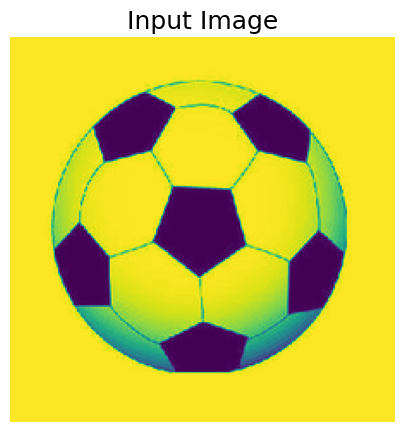

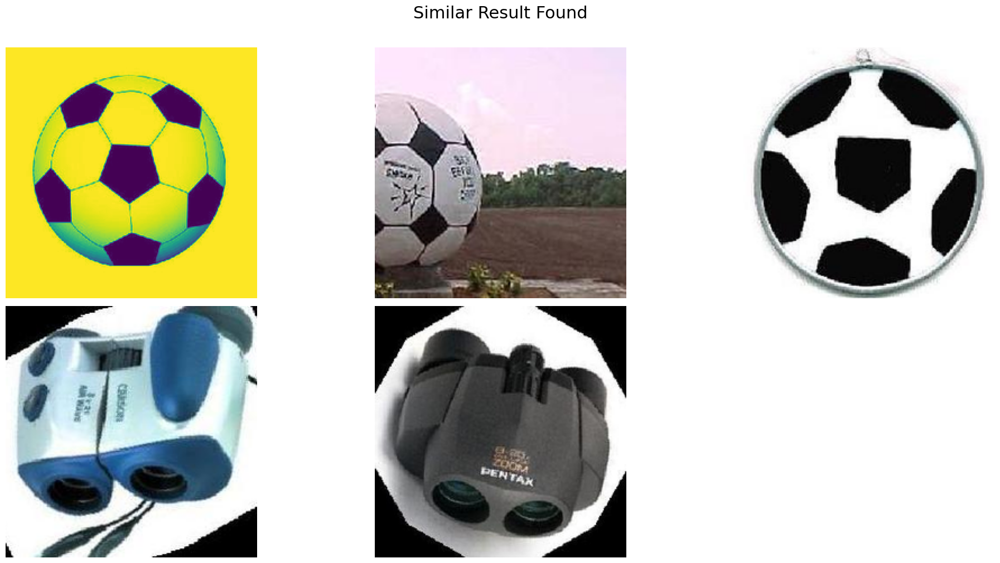

In [10]:
# Plot similar images to the first image in the list
img_path = image_list[0]
st.plot_similar_images(image_path=img_path, number_of_images=5)

# Cluster the vector embeddings from metadata


In [11]:
NUMBER_OF_CLUSTERS = 15
clustered_images = st.cluster_images(n_clusters=NUMBER_OF_CLUSTERS)
clustered_images.head()

running k-means on cuda:0..


[running kmeans]: 18it [00:00, 18.33it/s, center_shift=0.000000, iteration=18, tol=0.000100]


,images_paths,features,cluster
0,../datasets/combined/images/soccer_ball/image_...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.029...",2
1,../datasets/combined/images/joshua_tree/image_...,"[0.0, 0.028690215, 0.0, 0.0, 0.021845646, 0.0,...",10
2,../datasets/combined/images/trilobite/image_00...,"[0.025993535, 0.0, 0.00028825694, 0.0, 0.0, 0....",7
3,../datasets/combined/images/wheelchair/image_0...,"[0.0, 0.0, 0.0, 0.06804635, 0.007848067, 0.0, ...",3
4,../datasets/combined/images/schooner/image_001...,"[0.020615702, 0.0, 0.0, 0.0, 0.024134587, 0.0,...",5


In [12]:
# Get the image paths of the first cluster
st.get_clustered_images(cluster_id=0)

['../datasets/combined/images/laptop/image_0054.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0172.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0352.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0178.jpg',
 '../datasets/combined/images/dollar_bill/image_0048.jpg',
 '../datasets/combined/images/snoopy/image_0025.jpg',
 '../datasets/combined/images/garfield/image_0001.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0136.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0029.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0230.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0056.jpg',
 '../datasets/combined/images/dollar_bill/image_0014.jpg',
 '../datasets/combined/images/BACKGROUND_Google/image_0098.jpg',
 '../datasets/combined/images/dollar_bill/image_0044.jpg',
 '../datasets/combined/images/garfield/image_0002.jpg',
 '../datasets/combined/images/dollar_bill/image_0050.jpg',
 '../datasets/combined/i

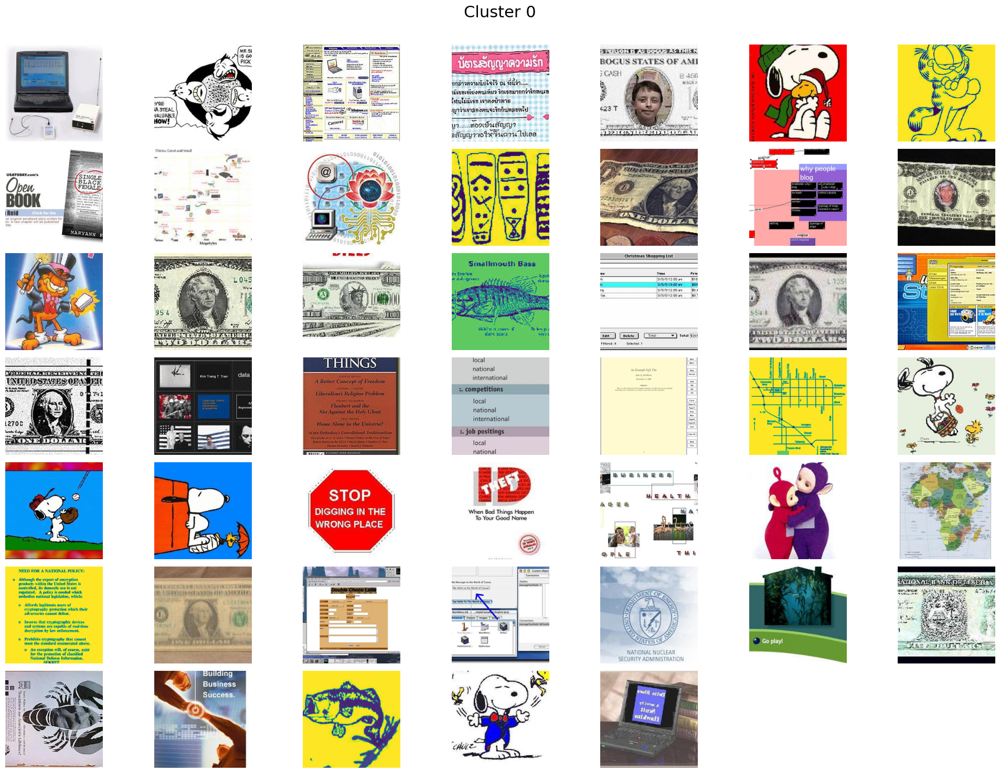

In [13]:
# Plot all images in the first cluster
st.plot_cluster_images(cluster_id=0)

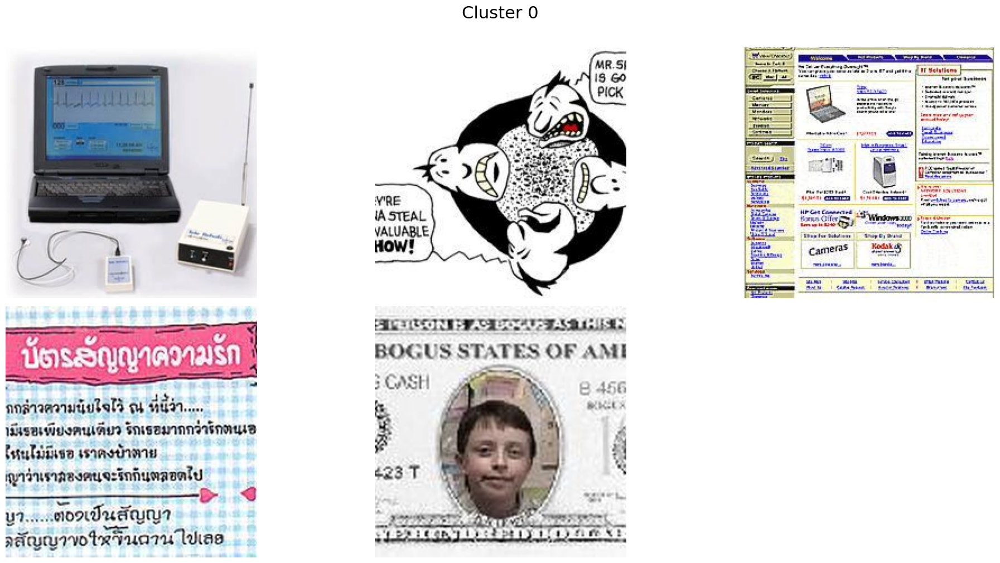

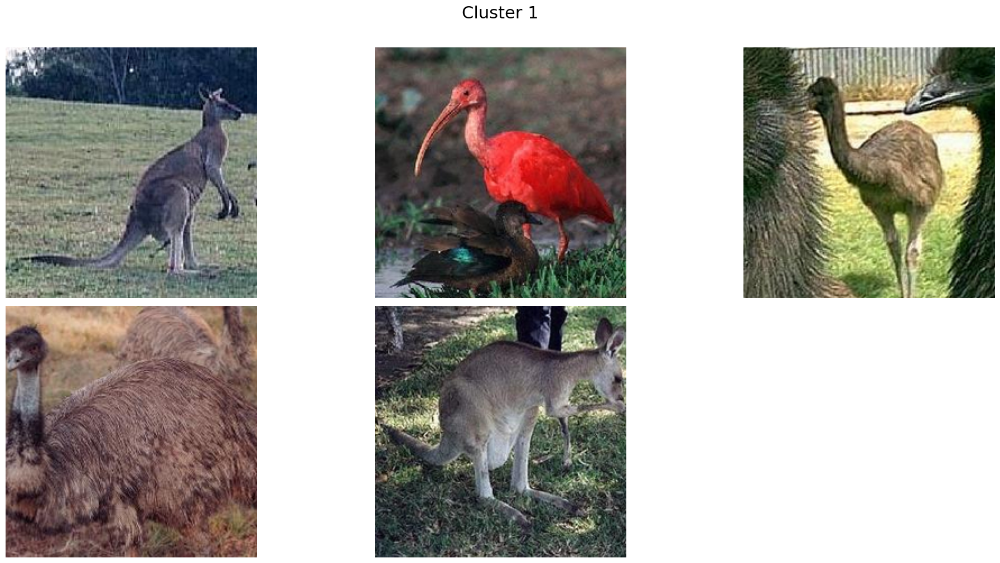

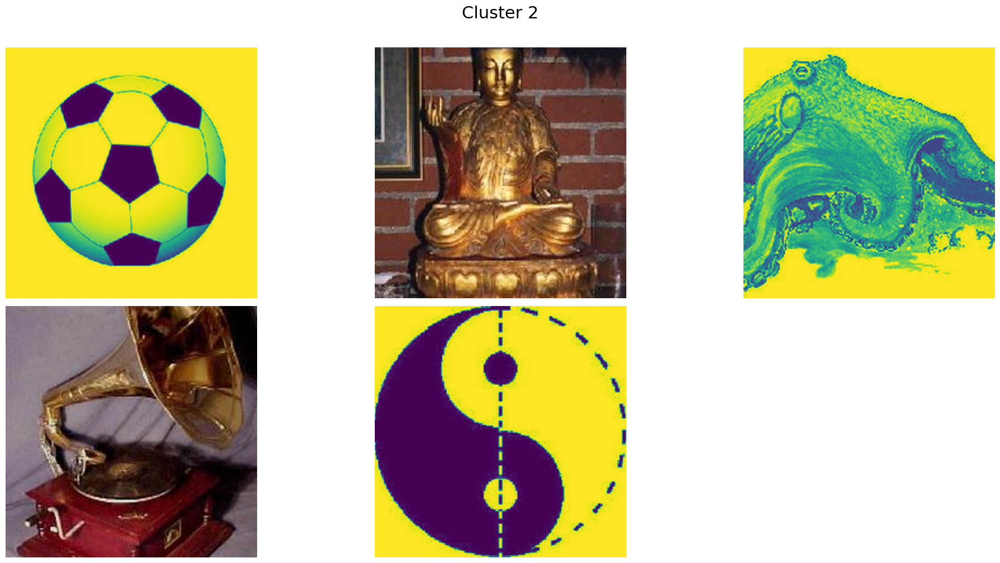

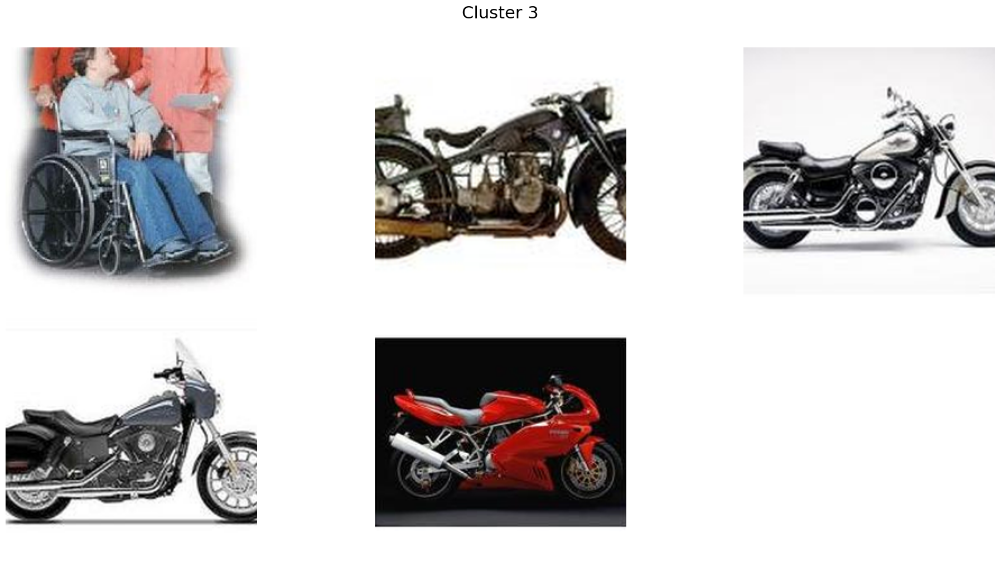

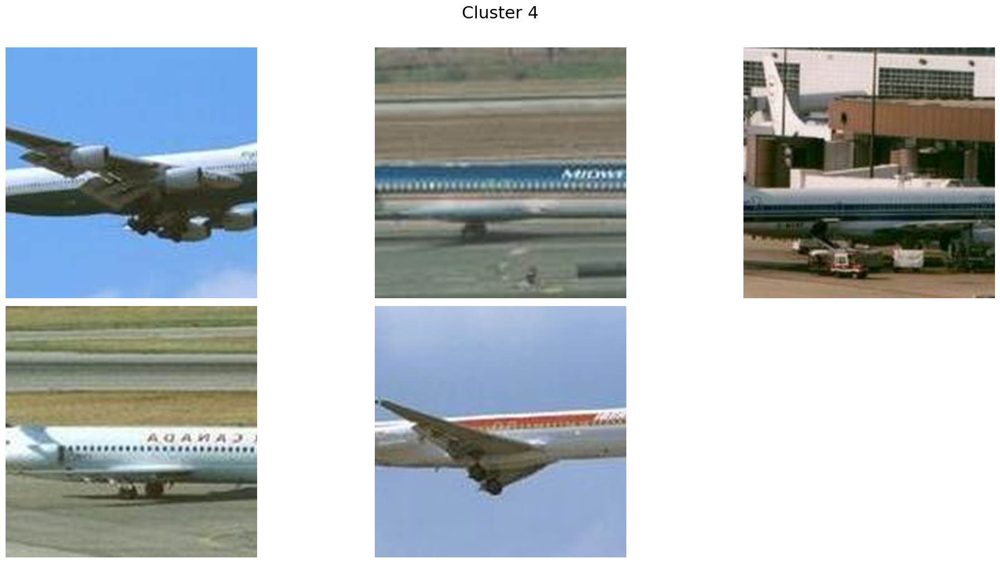

...

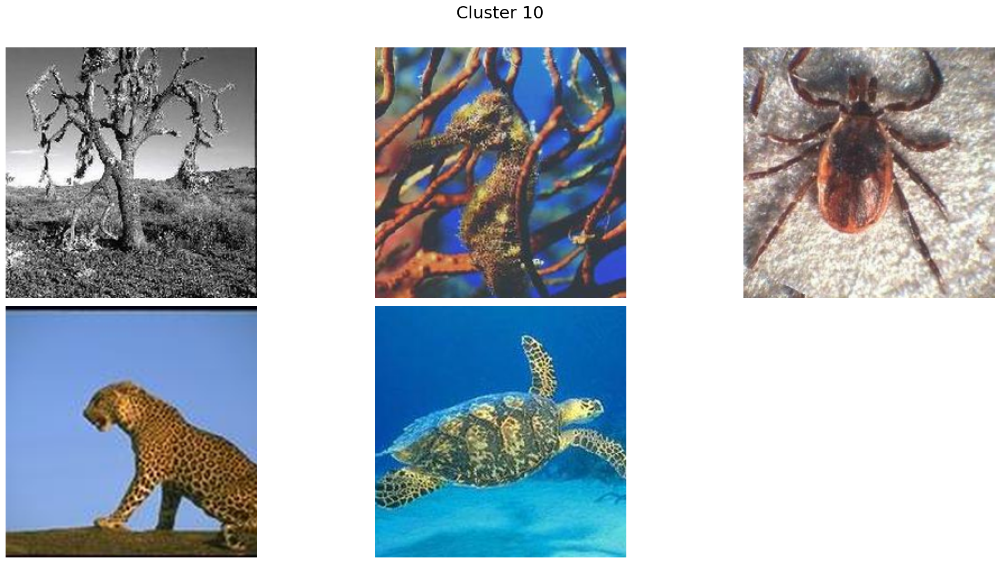

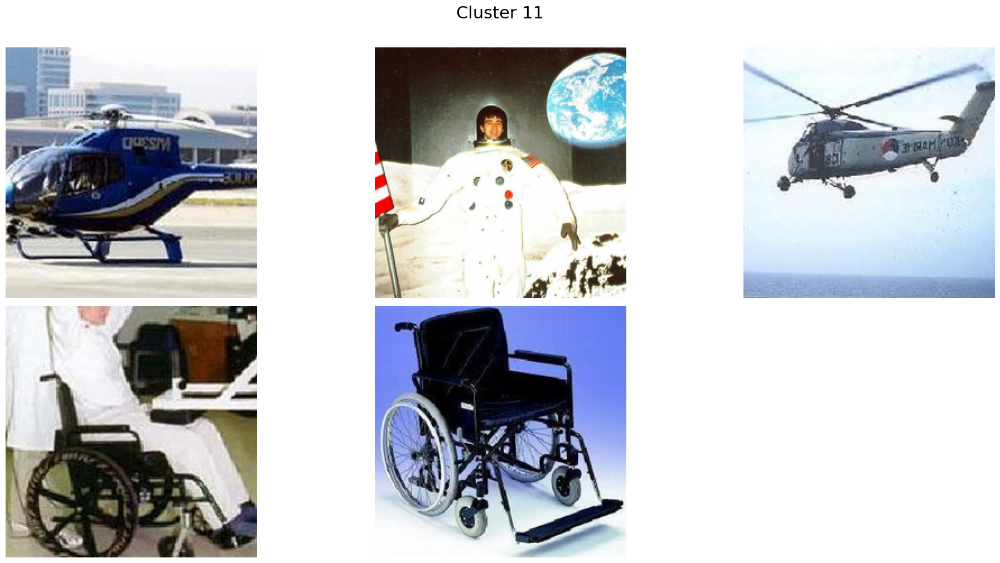

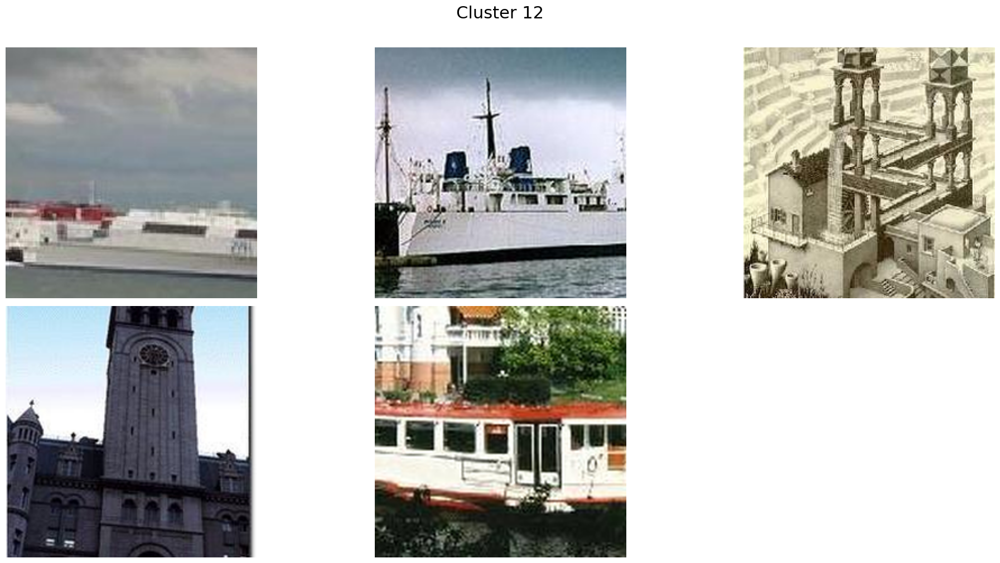

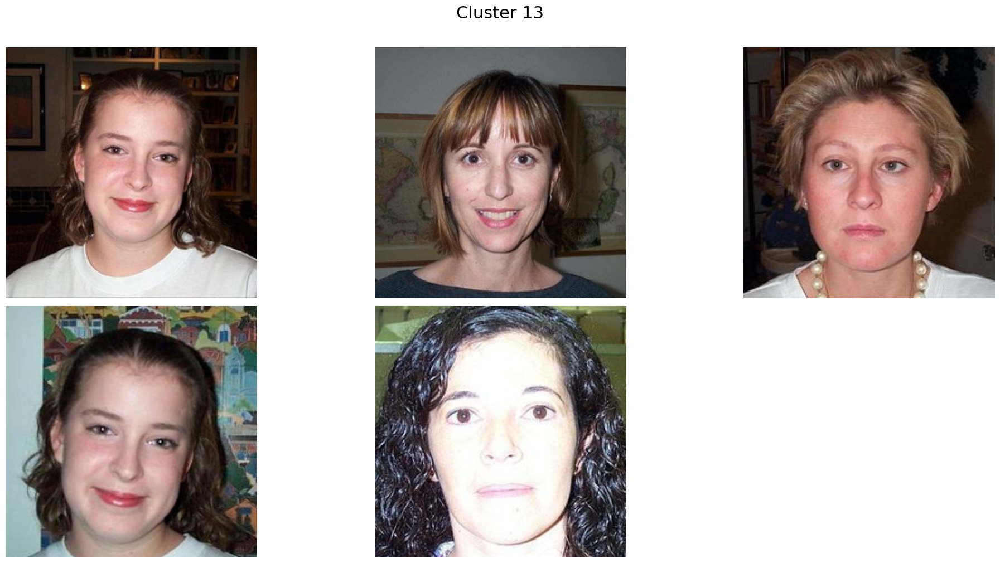

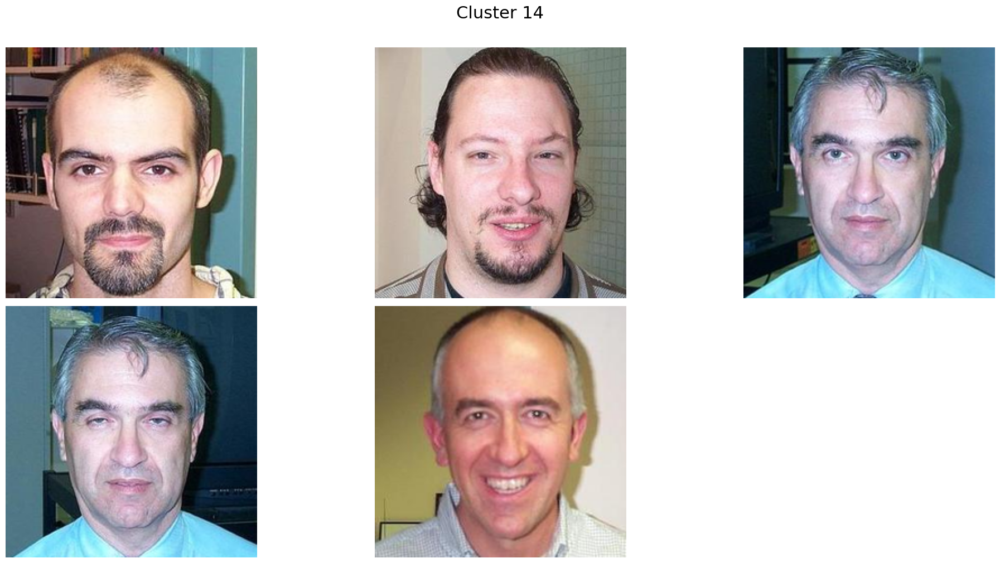

In [14]:
# Plot the first 10 images in each cluster
for i in range(NUMBER_OF_CLUSTERS):
    st.plot_cluster_images(cluster_id=i, number_of_images=5)

In [15]:
# Save each cluster to a folder with the cluster number
CLUSTERS_FOLDER_PATH = f'./clusters_{NUMBER_OF_CLUSTERS}'
st.save_clustered_images(save_dir=CLUSTERS_FOLDER_PATH)

100%|██████████| 20/20 [00:03<00:00,  5.42it/s]


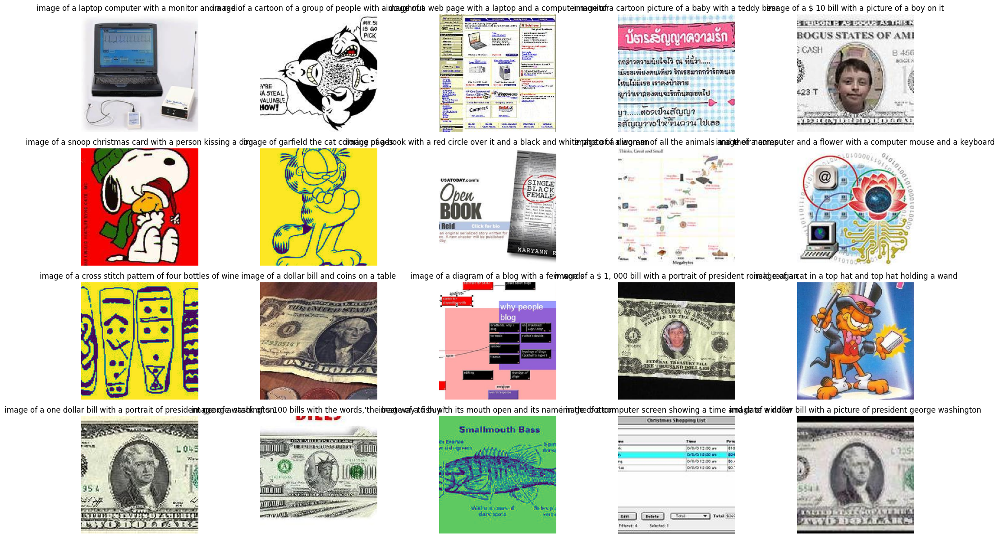

In [16]:
# Caption the first 20 images in the first cluster
cluster_0 = st.get_clustered_images(cluster_id=0)[:20]
captioned_images = st.caption_images(images_paths=cluster_0, starting_text='image of')
st.plot_captioned_images(captioned_images)

In [17]:
LLM_MODEL = "mistral:7b"

chat = ChatOllama(
    model=LLM_MODEL,
    temperature=0.8,
)

def get_best_topic(captions, tries=0):
    def prompt(captions):
        return f"""
    You have been provided with the following list of descriptions of images:
    descriptions: {captions}

    What is the best topic for these captions?

    You are allowed to use the maximum of 3 words for the topic.
    Write the topic in lowercase without any special characters or spaces.
    Make sure to write the topic in the desired format.
    
    Answer in this format:
    Topic: topic
    """

    answer = chat(
        [
            SystemMessage(content=prompt(captions)),
            HumanMessage(content="What is the best topic for these captions?"),
        ]
    ).content

    match = re.search(r'Topic: (.*)', answer)
    if match:
        return match.group(1)
    elif tries < 3:
        return get_best_topic(texts, tries + 1)
    else:
        return "Other"

# Get the best topic for the first 10 images in the first cluster
texts = captioned_images['caption'].to_list()
get_best_topic(texts)

'images (computers, money, animals, people)'

In [18]:
# Get the topics for all clusters
for i in range(NUMBER_OF_CLUSTERS):
    cluster_images = st.get_clustered_images(cluster_id=i)[:20]
    captioned_images = st.caption_images(images_paths=cluster_images)
    texts = captioned_images['caption'].to_list()
    topic = get_best_topic(texts)
    # add topic column to the metadata
    clustered_images.loc[clustered_images['cluster'] == i, 'topic'] = topic
    print(f"Cluster {i}: {topic}")

100%|██████████| 20/20 [00:03<00:00,  5.69it/s]


Cluster 0: images (general)


100%|██████████| 20/20 [00:03<00:00,  5.70it/s]


Cluster 1: animals in nature


100%|██████████| 20/20 [00:03<00:00,  5.82it/s]


Cluster 2: images - soccer, buddha, octopus, gramphone, yin\_yang, headphones, woman, vase, display, rabbit, machine, statue, teapot, camera, table, barrel, bathroom, brain, coffee


100%|██████████| 20/20 [00:03<00:00,  5.72it/s]


Cluster 3: motorcycles, women, wheelchair (if including that description), parking.


100%|██████████| 20/20 [00:03<00:00,  5.70it/s]


Cluster 4: airplanes / runways / sky


100%|██████████| 20/20 [00:03<00:00,  5.57it/s]


Cluster 5: sailboat images


100%|██████████| 20/20 [00:03<00:00,  5.98it/s]


Cluster 6: watch descriptions


100%|██████████| 20/20 [00:03<00:00,  5.48it/s]


Cluster 7: images (generic), fossils, dragonsflies


100%|██████████| 20/20 [00:03<00:00,  5.90it/s]


Cluster 8: musical\_instruments\_and\_images


100%|██████████| 20/20 [00:03<00:00,  5.75it/s]


Cluster 9: flowers, insects, objects


100%|██████████| 20/20 [00:03<00:00,  5.81it/s]


Cluster 10: animals, trees, desert, ocean, zoo, painting, dinosaur, table, alligator, hedgehog, computer, scorpion, large\_animal, couch, kangaroo, crocodile, mountain\_lion, wild, tick, long\_tail


100%|██████████| 20/20 [00:03<00:00,  5.47it/s]


Cluster 11: helicopters, space, wheelchairs, vehicles


100%|██████████| 16/16 [00:02<00:00,  5.71it/s]


Cluster 12: water scenes, buildings, animals


100%|██████████| 20/20 [00:03<00:00,  5.82it/s]


Cluster 13: women, clothing, accessories


100%|██████████| 20/20 [00:03<00:00,  5.42it/s]


Cluster 14: men with shirts


In [19]:
# copy CLUSTERS_FOLDER_PATH to CLUSTERS_FOLDER_PATH}_topics, renaming the folders inside to correspond topic
CLUSTERS_FOLDER_PATH_TOPICS = f'{CLUSTERS_FOLDER_PATH}_topics'
os.makedirs(CLUSTERS_FOLDER_PATH_TOPICS, exist_ok=True)
for i in range(NUMBER_OF_CLUSTERS):
    topic = clustered_images[clustered_images['cluster'] == i]['topic'].values[0]
    os.makedirs(f'{CLUSTERS_FOLDER_PATH_TOPICS}/{i}_{topic}', exist_ok=True)
    shutil.copytree(f'{CLUSTERS_FOLDER_PATH}/{i}', f'{CLUSTERS_FOLDER_PATH_TOPICS}/{i}_{topic}', dirs_exist_ok=True)